## Exploratory Data Analysis for the Loan Campaign response dataset

In [1]:
import pandas as pd
import os
import altair as alt
from sklearn.model_selection import train_test_split

In [2]:
# Save a vega-lite spec and a PNG blob for each plot in the notebook
alt.renderers.enable('mimetype')
alt.data_transformers.disable_max_rows()

DataTransformerRegistry.enable('default')

In [3]:
loan_campaign_response_dataset = pd.read_csv('../data/raw/PL_XSELL.csv')

train_df, test_df = train_test_split(loan_campaign_response_dataset, train_size=0.8, test_size=0.2, random_state=123)
try:
    train_df.to_csv('../data/preprocessed/train.csv', index = False, encoding='utf-8')
    test_df.to_csv('../data/preprocessed/test.csv', index = False, encoding='utf-8')
except:
    os.makedirs(os.path.dirname('../data/preprocessed'))
    train_df.to_csv('../data/preprocessed/train.csv', index = False, encoding='utf-8')
    test_df.to_csv('../data/preprocessed/test.csv', index = False, encoding='utf-8')

In [4]:
train_df = pd.read_csv('../data/preprocessed/train.csv')

In [5]:
train_df.shape

(16000, 40)

In [6]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16000 entries, 0 to 15999
Data columns (total 40 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   CUST_ID                   16000 non-null  object 
 1   TARGET                    16000 non-null  int64  
 2   AGE                       16000 non-null  int64  
 3   GENDER                    16000 non-null  object 
 4   BALANCE                   16000 non-null  float64
 5   OCCUPATION                16000 non-null  object 
 6   AGE_BKT                   16000 non-null  object 
 7   SCR                       16000 non-null  int64  
 8   HOLDING_PERIOD            16000 non-null  int64  
 9   ACC_TYPE                  16000 non-null  object 
 10  ACC_OP_DATE               16000 non-null  object 
 11  LEN_OF_RLTN_IN_MNTH       16000 non-null  int64  
 12  NO_OF_L_CR_TXNS           16000 non-null  int64  
 13  NO_OF_L_DR_TXNS           16000 non-null  int64  
 14  TOT_NO

From the above output, it can be confirmed that there are **no missing values** in the train dataset.

In [7]:
train_df.describe()

,TARGET,AGE,BALANCE,SCR,HOLDING_PERIOD,LEN_OF_RLTN_IN_MNTH,NO_OF_L_CR_TXNS,NO_OF_L_DR_TXNS,TOT_NO_OF_L_TXNS,NO_OF_BR_CSH_WDL_DR_TXNS,...,NO_OF_IW_CHQ_BNC_TXNS,NO_OF_OW_CHQ_BNC_TXNS,AVG_AMT_PER_ATM_TXN,AVG_AMT_PER_CSH_WDL_TXN,AVG_AMT_PER_CHQ_TXN,AVG_AMT_PER_NET_TXN,AVG_AMT_PER_MOB_TXN,FLG_HAS_NOMINEE,FLG_HAS_OLD_LOAN,random
count,16000.000000,16000.000000,1.600000e+04,16000.000000,16000.000000,16000.000000,16000.000000,16000.000000,16000.000000,16000.000000,...,16000.000000,16000.000000,16000.000000,16000.000000,16000.000000,16000.000000,16000.000000,16000.000000,16000.000000,16000.000000
mean,0.124375,38.413562,5.089402e+05,440.865500,14.920500,125.341063,12.343500,6.648313,18.985063,1.888750,...,0.042688,0.046125,7435.696487,240642.891646,24996.121004,179119.702099,20272.152793,0.900125,0.493375,0.500943
std,0.330019,9.594544,7.189375e+05,250.189435,8.628946,55.019796,12.096865,7.678578,17.715899,2.252818,...,0.203083,0.210060,7201.405004,268437.659693,49122.028676,281407.523224,46436.706449,0.299843,0.499972,0.290683
min,0.000000,21.000000,0.000000e+00,100.000000,1.000000,29.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000011
25%,0.000000,30.000000,6.547212e+04,228.000000,7.000000,79.000000,6.000000,2.000000,9.000000,1.000000,...,0.000000,0.000000,0.000000,2265.912500,0.000000,0.000000,0.000000,1.000000,0.000000,0.247454
50%,0.000000,38.000000,2.315183e+05,365.000000,15.000000,126.000000,10.000000,5.000000,14.000000,1.000000,...,0.000000,0.000000,6100.000000,146970.500000,8750.000000,0.000000,0.000000,1.000000,0.000000,0.505046
75%,0.000000,47.000000,6.509098e+05,646.000000,22.000000,172.000000,15.000000,7.000000,21.000000,2.000000,...,0.000000,0.000000,13500.000000,379970.000000,28410.000000,257655.000000,0.000000,1.000000,1.000000,0.752351
max,1.000000,55.000000,8.360431e+06,999.000000,31.000000,221.000000,75.000000,74.000000,149.000000,15.000000,...,2.000000,2.000000,25000.000000,999640.000000,537842.220000,999854.000000,199470.000000,1.000000,1.000000,0.999908


In [8]:
train_df['TARGET'].value_counts(normalize=True)

0    0.875625
1    0.124375
Name: TARGET, dtype: float64

The target response distribution for 1 (yes) and 0 (No) is not balanced i.e. there is some evident class imbalance in the train dataset which might need to be handled for the model performance. But, the EDA will be performed on this same train dataset to gain insights from the raw dataset before treating class imbalance.

### High level data observations

It can be observed in the train set that there are columns 
- `TOT_NO_OF_L_TXNS` (Total no. of transactions) 
- `NO_OF_L_CR_TXNS`  (No. of Credit transactions)
- `NO_OF_L_DR_TXNS`  (No. of Debit Transactions)

Let's explore if `TOT_NO_OF_L_TXNS` = `NO_OF_L_CR_TXNS + NO_OF_L_DR_TXNS` because if they are related, then the columns would be redundant to use in the model


In [8]:
(train_df['TOT_NO_OF_L_TXNS'] == train_df['NO_OF_L_CR_TXNS'] + train_df['NO_OF_L_DR_TXNS']).value_counts()

True     15921
False       79
dtype: int64

Similarly, there are columns related to debit transactions which could be related. 
- `NO_OF_L_DR_TXNS`  (No. of Debit Transactions)
- `NO_OF_BR_CSH_WDL_DR_TXNS` (No. of Branch Cash Withdrawal Transactions)
- `NO_OF_ATM_DR_TXNS`  (No. of ATM Debit Transactions)
- `NO_OF_NET_DR_TXNS`  (No. of Net Debit Transactions)
- `NO_OF_MOB_DR_TXNS`  (No. of Mobile Banking Debit Transactions)
- `NO_OF_CHQ_DR_TXNS`  (No. of Cheque Debit Transactions)  

It can be explored in the train set if `NO_OF_L_DR_TXNS` = `NO_OF_BR_CSH_WDL_DR_TXNS + NO_OF_ATM_DR_TXNS + NO_OF_NET_DR_TXNS + NO_OF_MOB_DR_TXNS + NO_OF_CHQ_DR_TXNS`

In [9]:
(train_df['NO_OF_L_DR_TXNS'] == train_df['NO_OF_BR_CSH_WDL_DR_TXNS'] +
                                train_df['NO_OF_ATM_DR_TXNS'] +
                                train_df['NO_OF_NET_DR_TXNS'] +
                                train_df['NO_OF_MOB_DR_TXNS'] +
                                train_df['NO_OF_CHQ_DR_TXNS']
).value_counts()

True    16000
dtype: int64

So, it can be observed that TOT_NO_OF_L_TXNS is not always equal to the sum of NO_OF_L_CR_TXNS + NO_OF_L_DR_TXNS whereas NO_OF_L_DR_TXNS is equal to the sum of all number of debit transactions provided in the train data. So, there could be possibility that not all credit transactions are recorded/ present in the given data but we have records of debit level transactions.

**Another observation:** We have two columns AGE and AGE_BKT (AGE Bucket) in the data , so let's explore the categories in the AGE_BKT

In [11]:
train_df['AGE_BKT'].value_counts()

26-30    2744
31-35    2743
41-45    2443
>50      2439
36-40    2234
46-50    1991
<25      1406
Name: AGE_BKT, dtype: int64

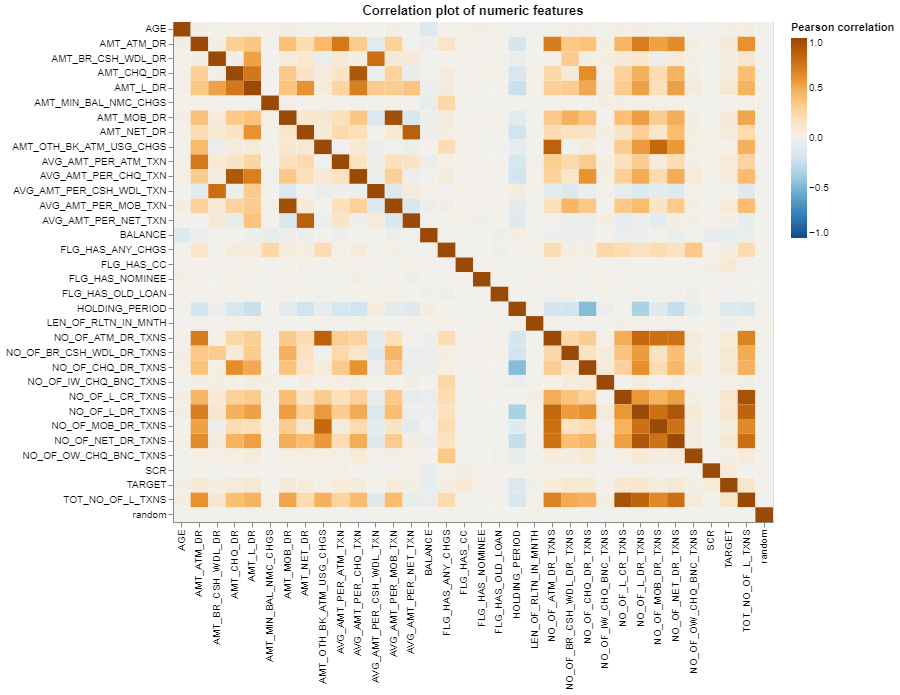

In [10]:
train_df_corr = train_df.corr().stack().reset_index(name='corr')


train_corr_plot = (
                  alt.Chart(train_df_corr, title='Correlation plot of numeric features')
                     .encode(x=alt.X('level_0', title=''),
                             y=alt.Y('level_1', title=''),
                             color=alt.Color('corr', scale=alt.Scale(scheme='blueorange',
                                                                      domain=(-1,1)),
                             title='Pearson correlation'))
                     .mark_rect()).properties(width=600, height=500
                  )

train_corr_plot

From the correlation plot, it can be seen that TARGET column doesn't have a strong linear correlation with any of the input variables as the range of correlation varies between -0.4 to 0.2 with the target column. TARGET seems to have little negative correlation with HOLDING_PERIOD.

Also, a strong correlation between explanatory variables can be observed for No. of transactions , Amount withdrawn from transactions and average amount per transaction. The explanatory variables under these seems to be highly correlated with each other.

#### Let's explore the relationship of target with numeric explanatory variable.

In [11]:
# For EDA purposes, converting Target response to represent category Yes or No

train_df.loc[(train_df['TARGET'] == 1), 'TARGET'] = 'Yes'
train_df.loc[(train_df['TARGET'] == 0), 'TARGET'] = 'No'

In [12]:
train_df['TARGET'].value_counts()

No     14010
Yes     1990
Name: TARGET, dtype: int64

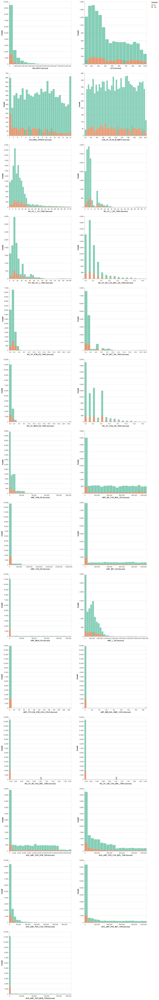

In [26]:
numeric_cols = ['BALANCE',
                 'SCR',
                 'HOLDING_PERIOD',
                 'LEN_OF_RLTN_IN_MNTH',
                 'NO_OF_L_CR_TXNS',
                 'NO_OF_L_DR_TXNS',
                 'TOT_NO_OF_L_TXNS',
                 'NO_OF_BR_CSH_WDL_DR_TXNS',
                 'NO_OF_ATM_DR_TXNS',
                 'NO_OF_NET_DR_TXNS',
                 'NO_OF_MOB_DR_TXNS',
                 'NO_OF_CHQ_DR_TXNS',
                 'AMT_ATM_DR',
                 'AMT_BR_CSH_WDL_DR',
                 'AMT_CHQ_DR',
                 'AMT_NET_DR',
                 'AMT_MOB_DR',
                 'AMT_L_DR',
                 'AMT_OTH_BK_ATM_USG_CHGS',
                 'AMT_MIN_BAL_NMC_CHGS',
                 'NO_OF_IW_CHQ_BNC_TXNS',
                 'NO_OF_OW_CHQ_BNC_TXNS',
                 'AVG_AMT_PER_ATM_TXN',
                 'AVG_AMT_PER_CSH_WDL_TXN',
                 'AVG_AMT_PER_CHQ_TXN',
                 'AVG_AMT_PER_NET_TXN',
                 'AVG_AMT_PER_MOB_TXN'
                ]


train_numeric_plot = (
    alt.Chart(train_df).mark_bar(opacity=0.8)
       .encode(alt.X(alt.repeat(), type='quantitative', bin=alt.Bin(maxbins=40)),
               alt.Y('count(TARGET)', stack=False, title='Count'),
               color=alt.Color('TARGET', scale=alt.Scale(scheme='set2'))
               ).properties(width=400,
                            height=400
                            )
                .repeat(numeric_cols,
                        columns=2
                       )
)

train_numeric_plot

### Observations from histograms of numeric variables
- A very obvious pattern observed is for `BALANCE` column. Those who have less balance i.e. less than 5,00,000 or 5 lakhs have shown more interest in the offer (it could be these customers require the loan money)

- Similarly, the customers who have very low holding period (1 day) i.e. the ability to hold their average monthly balance have shown more interest in the loan offer. This could be because they might have huge expenses in the month or have started monthly installments which automatically deducts money on day 1 of every month cycle and they are need of money.

- Another obvious pattern is that customers who have higher number of credit transactions i.e. `NO_OF_L_CR_TXNS` are less likely to show interest in loan and same is observed.

- Customers who have associated with bank recently i.e. their `LEN_OF_RLTN_IN_MNTH` with bank < 25 have shown no interest it's because may be they don't have credit history or not eligible to have loan.

- Rest of the columns have overlaps for range in explanatory variables and hence doesn't clearly distinguish between Yes or No.


#### Now let's explore the relationship of target with categorical explanatory variables.

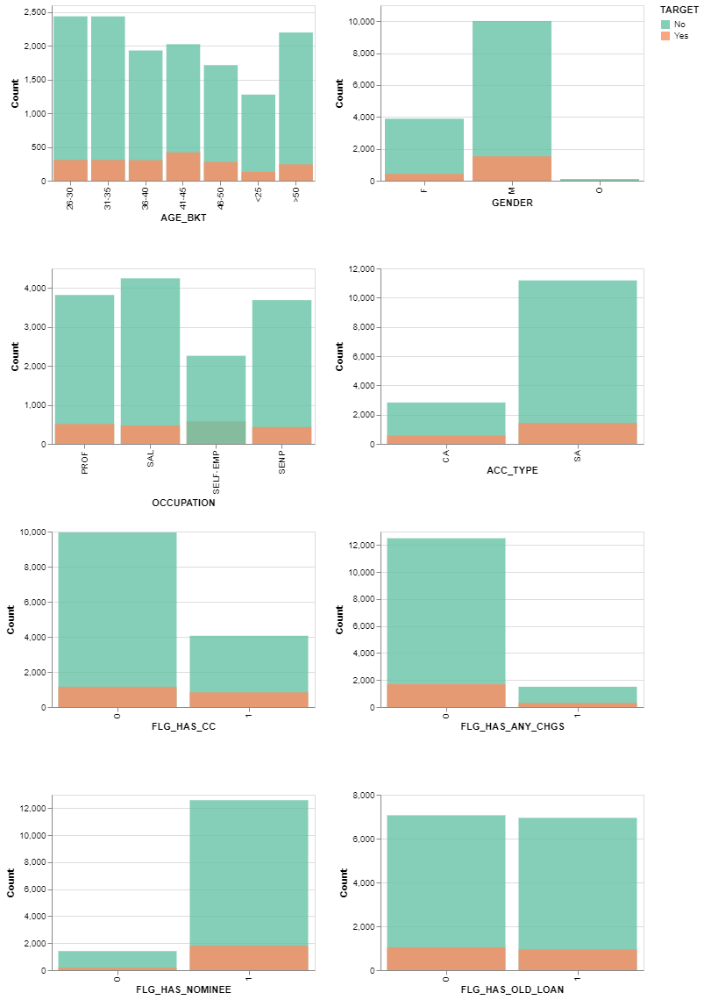

In [23]:
categorical_cols = ['AGE_BKT', 'GENDER', 'OCCUPATION', 'ACC_TYPE', 'FLG_HAS_CC',
                    'FLG_HAS_ANY_CHGS', 'FLG_HAS_NOMINEE', 'FLG_HAS_OLD_LOAN']

train_categorical_col_plot = (
    alt.Chart(train_df).mark_bar(opacity=0.8)
       .encode(alt.X(alt.repeat(), type='ordinal'),
               alt.Y('count(TARGET)', stack=False, title='Count'),
               alt.Color('TARGET', scale=alt.Scale(scheme='set2'))
               ).properties(width=300,
                            height=200)
                .repeat(categorical_cols,
                        columns=2
                       )
                
)

train_categorical_col_plot

### Observations from histogram of categorical variables

- The plot for AGE_BKT tells us that the customers in age group **41-45 have shown most interest** in the loan offer whereas customers in age group 26-30, 31-35, 36-40, 46-50 and even >50 has shown similar amount of interest but lower than 41-45. The least amount of interest is shown by age group < 25 , this could be because they likely don't have enough credit history or huge investments to be eligible for personal loans. Also, this age group is more likely to go for education loan over personal loan and hence could be one of the reason for low interest.


- The distribution of response based on Gender tells us that the targeted customers for loan campaign has Males over Females and Others. Calculating the conversion rate (in terms of their interest in offer) , **Males have shown a little more interest** roughly around (~ 1500 / 10, 000) 15% of Male population in the train set has shown interest whereas 12.5% (~ 500 / 4000) of Female population has shown interest in the offer. The Other category has least population in the train data and has shown no interest in the offer.

- Basis on occupation, the distribution of response tells us that **Self-EMP customers** are slightly more interested in the personal loan offer than Professionals (PROF), Salaried (SAL), SENP (SELF Employed Non Professionals & Professionals). This could be that self employed needs money to setup business or for other investments.

- Similarly, customers with Savings account, without any banking changes and with nominee seems more interested in the offer.

- Customer owning a credit or not , has old loan or not are equally interested in the loan offer.